In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import lightgbm as lgb

In [2]:
from sklearn.metrics import mean_squared_error, mean_absolute_error

In [3]:
data = pd.read_parquet('/main/data/MVideo_2/dataset_main_5_2.parquet')

In [4]:
data[['PRODUCT_ID', 'MAINCATEGORY_ID', 'SUBCATEGORY_ID',
       'STORE_ID', 'REGION', 'INTERNET',
       'WEEK(DATE)', 'MONTH(DATE)', 'CLUSTER']] = data[['PRODUCT_ID', 'MAINCATEGORY_ID', 'SUBCATEGORY_ID',
                                                          'STORE_ID', 'REGION', 'INTERNET',
                                                          'WEEK(DATE)', 'MONTH(DATE)', 'CLUSTER']].astype('category')

In [5]:
data.UNITS_SOLD_P1 = np.log1p(data.UNITS_SOLD_P1)

In [6]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2831698 entries, 0 to 2831697
Columns: 132 entries, DATE to NUM_STORES
dtypes: category(9), datetime64[ns](1), float32(102), float64(1), int32(19)
memory usage: 1.4 GB


In [7]:
data_train = data[data.DATE < '2018-03-18']

In [8]:
data_train.shape[0]

2377102

In [9]:
data_val = data[(data.DATE >= '2018-03-18') & (data.DATE < '2018-05-13')]

In [10]:
data_val.shape[0]

226359

In [11]:
data_test = data[data.DATE >= '2018-05-13']

In [12]:
data_test.shape[0]

228237

In [13]:
feat = [s for s in data.columns if s not in ['DATE', 'UNITS_SOLD_P1']]

In [14]:
dts = lgb.Dataset(data_train[feat], label = data_train.UNITS_SOLD_P1)

In [15]:
dts = dts.construct()

In [16]:
dtsv = dts.create_valid(data_val[feat], label = data_val.UNITS_SOLD_P1)

In [17]:
params = {
    'application': 'regression_l2',
    'learning_rate': 0.03,
    'num_leaves': 511,
    'metric': 'l2_root'
    }

In [18]:
bst = lgb.train(params, dts, valid_sets = [dtsv], valid_names = ['Validation'],
                num_boost_round = 10000, early_stopping_rounds = 20)

[1]	Validation's rmse: 0.403701
Training until validation scores don't improve for 20 rounds.
[2]	Validation's rmse: 0.40089
[3]	Validation's rmse: 0.39826
[4]	Validation's rmse: 0.395694
[5]	Validation's rmse: 0.393277
[6]	Validation's rmse: 0.391087
[7]	Validation's rmse: 0.388949
[8]	Validation's rmse: 0.386914
[9]	Validation's rmse: 0.384976
[10]	Validation's rmse: 0.383269
[11]	Validation's rmse: 0.381599
[12]	Validation's rmse: 0.379986
[13]	Validation's rmse: 0.378486
[14]	Validation's rmse: 0.377044
[15]	Validation's rmse: 0.375677
[16]	Validation's rmse: 0.374336
[17]	Validation's rmse: 0.373117
[18]	Validation's rmse: 0.371971
[19]	Validation's rmse: 0.370829
[20]	Validation's rmse: 0.369772
[21]	Validation's rmse: 0.368773
[22]	Validation's rmse: 0.367871
[23]	Validation's rmse: 0.366991
[24]	Validation's rmse: 0.366132
[25]	Validation's rmse: 0.365344
[26]	Validation's rmse: 0.364578
[27]	Validation's rmse: 0.363839
[28]	Validation's rmse: 0.363207
[29]	Validation's rmse: 0

In [19]:
pred = bst.predict(data_test[feat])

In [20]:
np.sqrt(mean_squared_error(np.expm1(data_test.UNITS_SOLD_P1), np.expm1(pred)))

0.890267597244707

In [21]:
mean_absolute_error(np.expm1(data_test.UNITS_SOLD_P1), np.expm1(pred))

0.4459107104491886

In [22]:
res = data_test[['DATE', 'PRODUCT_ID', 'STORE_ID', 'UNITS_SOLD_P1']].copy()

In [23]:
res['PRED_P1'] = pred

In [24]:
res.head()

,DATE,PRODUCT_ID,STORE_ID,UNITS_SOLD_P1,PRED_P1
index,,,,,
469481,2018-05-13,10009099,11,0.000000,0.171099
469482,2018-05-13,10009099,15,1.791759,0.172662
469483,2018-05-13,10009099,16,0.000000,0.165476
469484,2018-05-13,10009099,22,0.000000,0.397802
469485,2018-05-13,10009099,25,0.000000,0.267148


In [25]:
def plot_ts(df, store_id, product_id):
    data_part = df[(df['STORE_ID'] == store_id) & (df['PRODUCT_ID'] == product_id)]
    week_range = data_part.DATE.drop_duplicates().sort_values().values
    #week_range = np.arange(data_part['DATE'].min(), data_part['DATE'].max())# + 1)
    ts = pd.DataFrame()
    ts['DATE'] = week_range
    df = pd.merge(ts, data_part, on = 'DATE', how = 'left')[['DATE', 'UNITS_SOLD_P1', 'PRED_P1']].fillna(0)
    plt.figure(figsize=(15, 4))
    plt.plot(df['DATE'].values, np.expm1(df['UNITS_SOLD_P1'].values), 'g^-', label='true')
    plt.plot(df['DATE'].values, np.expm1(df['PRED_P1'].values), 'ro-', label='pred')
    plt.xlabel('# Week')
    plt.ylabel('Units sold')
    max_y = max(1, (np.expm1(df['UNITS_SOLD_P1'])).max(), (np.expm1(df['PRED_P1'])).max())
    plt.ylim((-0.05, max_y + 0.1))
    plt.title('The ts for product - %s and store - %s' % (product_id, store_id))
    plt.legend(loc='best')
    plt.show()

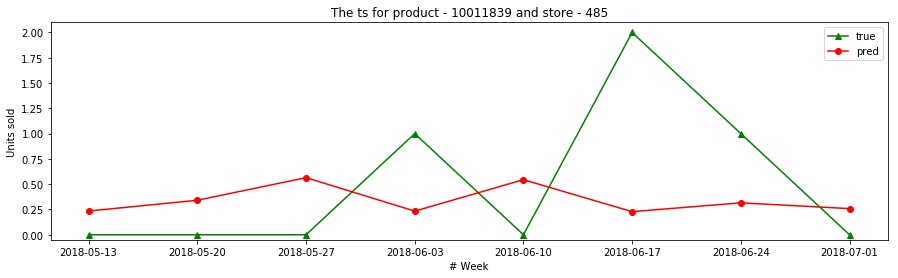

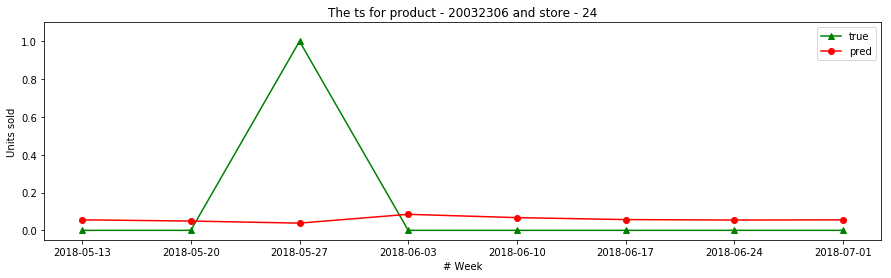

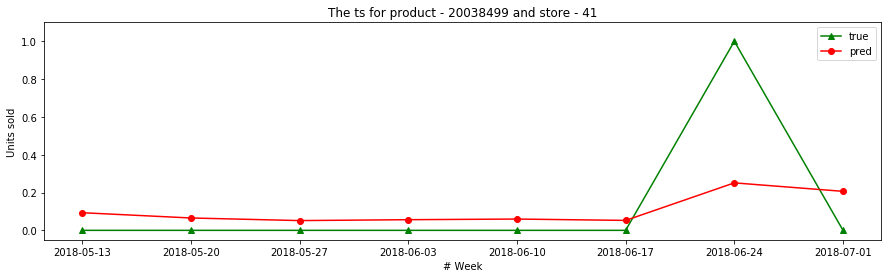

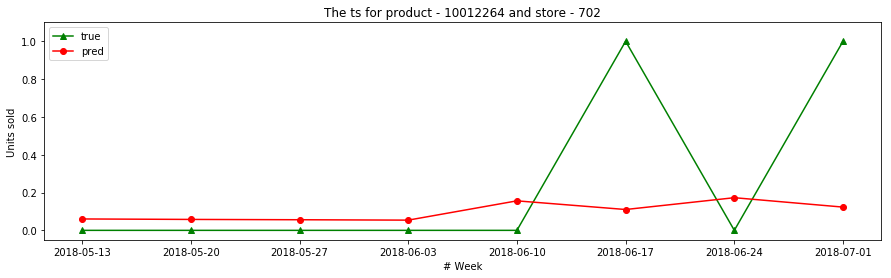

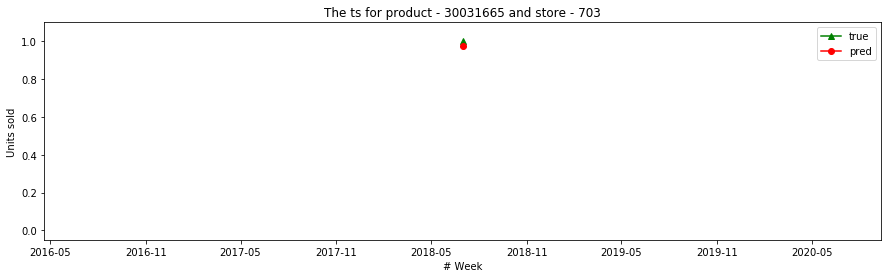

...

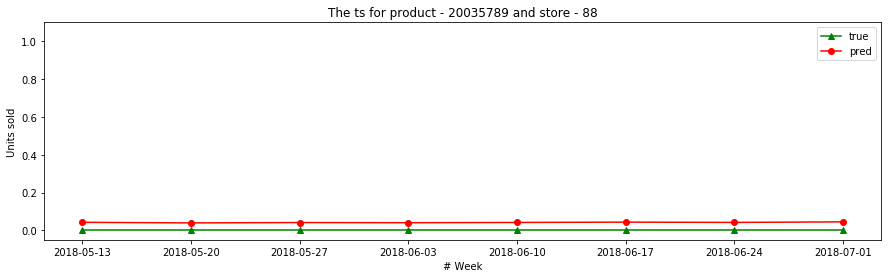

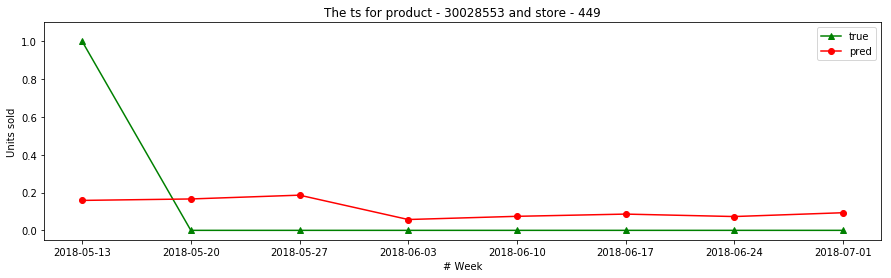

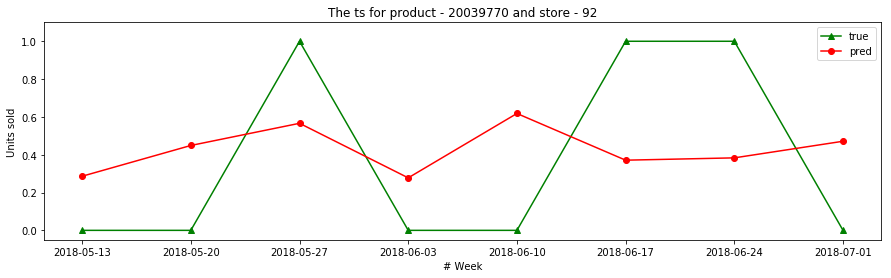

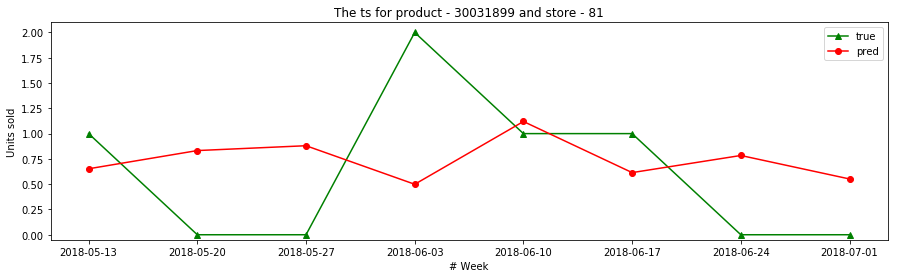

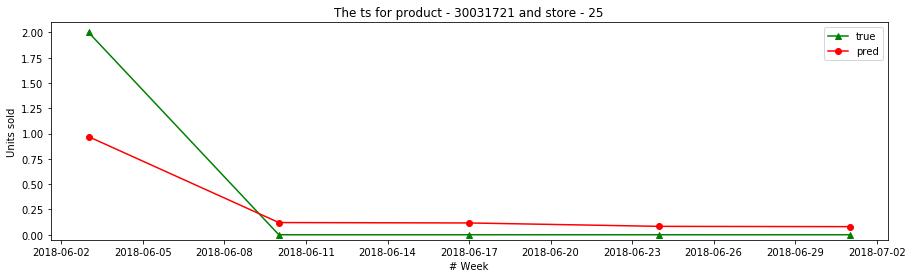

In [26]:
pairs = list(set(zip(res['STORE_ID'], res['PRODUCT_ID'])))

for i in range(len(pairs) // 100):
    store_id, product_id = pairs[i]
    plot_ts(res, store_id, product_id)

In [27]:
data_train2 = data[data.DATE < '2018-05-13']

In [28]:
dts2 = lgb.Dataset(data_train2[feat], label = data_train2.UNITS_SOLD_P1)

In [29]:
dts2 = dts2.construct()

In [30]:
bst2 = lgb.train(params, dts2, num_boost_round = 90)

In [31]:
pred2 = bst2.predict(data_test[feat])

In [34]:
np.sqrt(mean_squared_error(np.expm1(data_test.UNITS_SOLD_P1), np.expm1(pred2)))

0.86006719897221

In [35]:
mean_absolute_error(np.expm1(data_test.UNITS_SOLD_P1), np.expm1(pred2))

0.4434087485126328

In [36]:
res2 = data_test[['DATE', 'PRODUCT_ID', 'STORE_ID', 'UNITS_SOLD_P1']].copy()

In [37]:
res2['PRED_P1'] = pred2

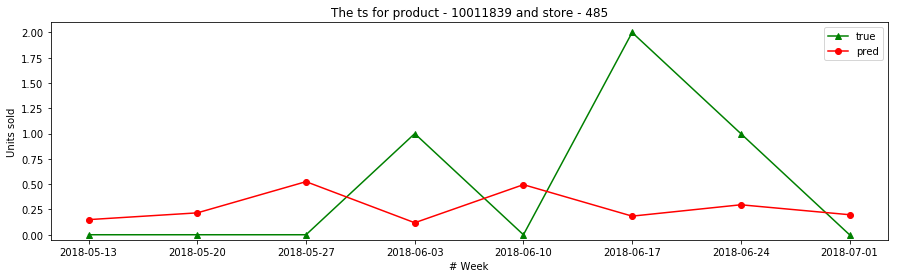

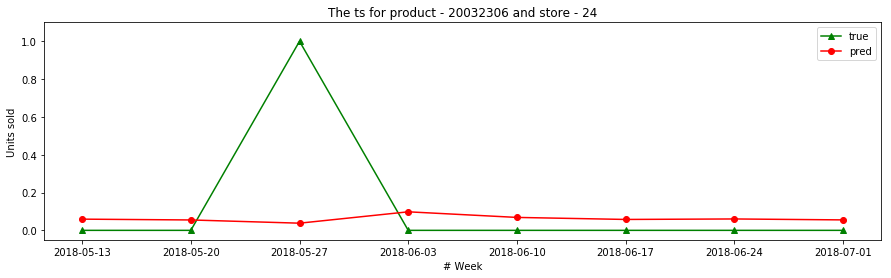

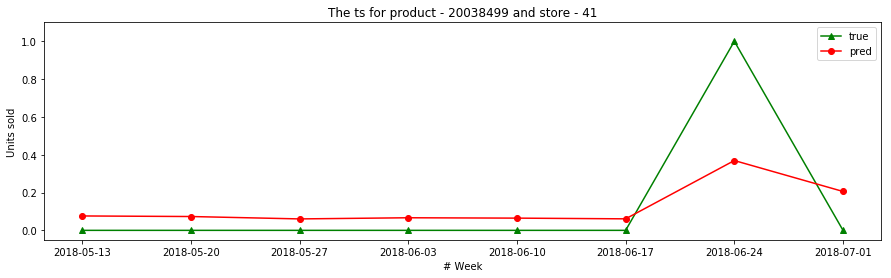

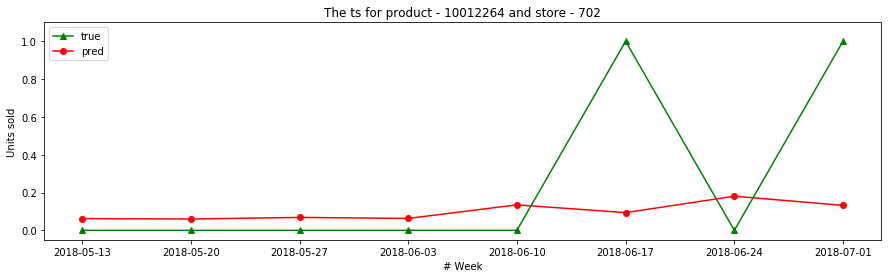

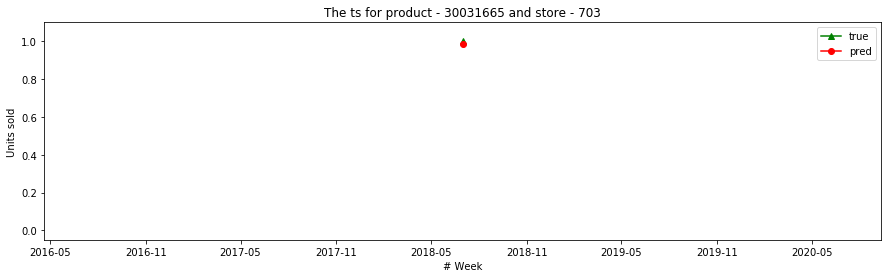

...

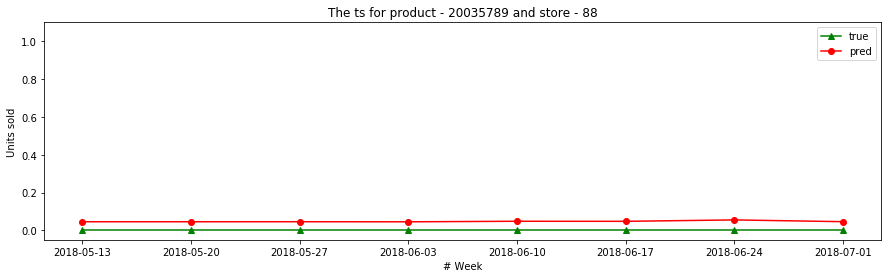

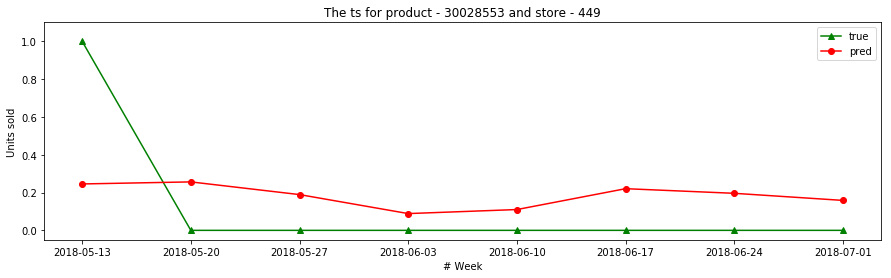

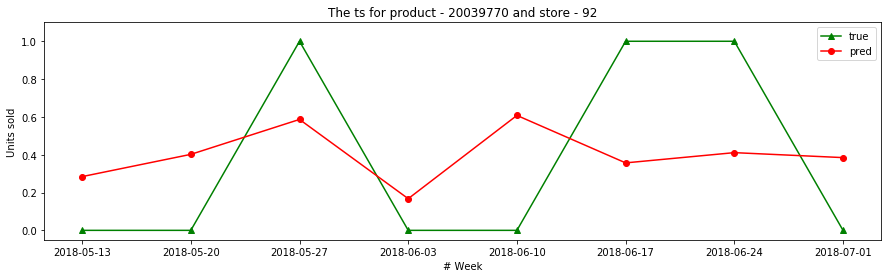

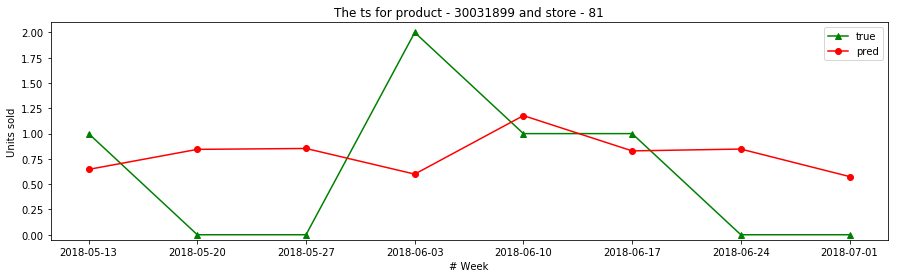

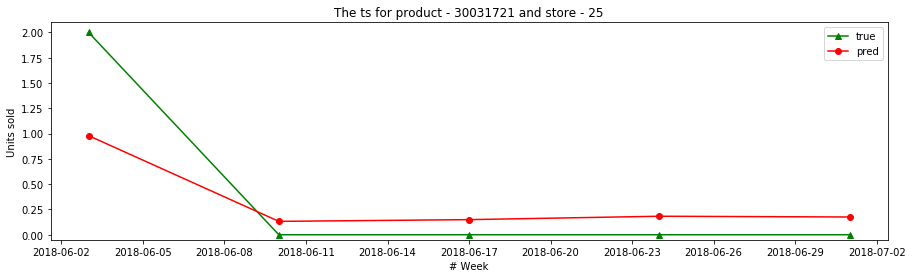

In [38]:
pairs = list(set(zip(res2['STORE_ID'], res2['PRODUCT_ID'])))

for i in range(len(pairs) // 100):
    store_id, product_id = pairs[i]
    plot_ts(res2, store_id, product_id)

In [39]:
sc = bst2.feature_importance(importance_type='gain')

In [40]:
score = pd.DataFrame(100 * sc / np.sum(sc),
                     index = bst2.feature_name(), columns = ['Score'])

In [41]:
score = score.sort_values('Score', ascending=False)

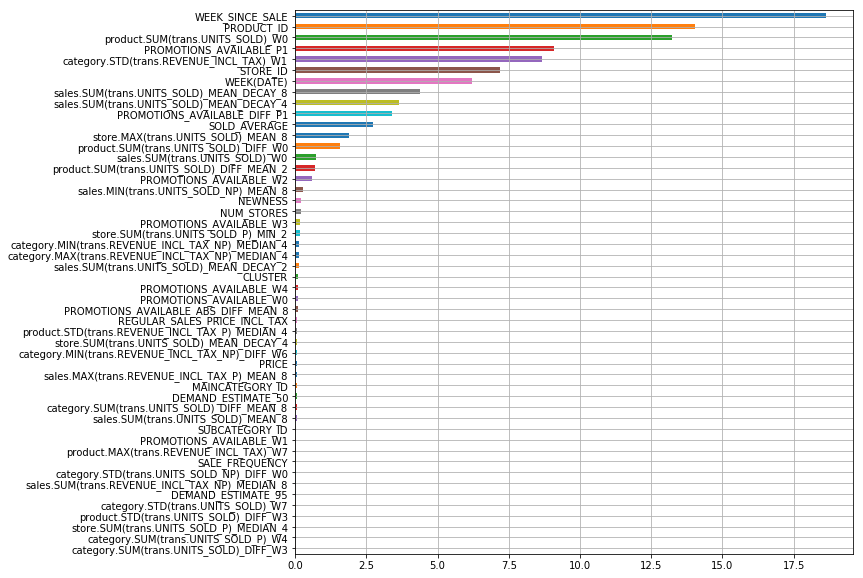

In [42]:
score.head(50).Score.plot.barh(grid=True, figsize=(10,10)).invert_yaxis()

In [43]:
fltr = pd.read_parquet('/main/data/MVideo_2/crosstest.parquet')

In [44]:
fltr.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 163122 entries, 3000 to 10833687
Data columns (total 3 columns):
STORE_ID      163122 non-null category
PRODUCT_ID    163122 non-null category
DATE          163122 non-null datetime64[ns]
dtypes: category(2), datetime64[ns](1)
memory usage: 3.1 MB


In [45]:
data_test2 = pd.merge(data_test, fltr, how = 'inner')

In [46]:
data_test2[['PRODUCT_ID', 'MAINCATEGORY_ID', 'SUBCATEGORY_ID',
       'STORE_ID', 'REGION', 'INTERNET',
       'WEEK(DATE)', 'MONTH(DATE)']] = data_test2[['PRODUCT_ID', 'MAINCATEGORY_ID', 'SUBCATEGORY_ID',
                                                          'STORE_ID', 'REGION', 'INTERNET',
                                                          'WEEK(DATE)', 'MONTH(DATE)']].astype('category')

In [47]:
pred3 = bst2.predict(data_test2[feat])

In [49]:
np.sqrt(mean_squared_error(np.expm1(data_test2.UNITS_SOLD_P1), np.expm1(pred3)))

0.7535231080073796

In [50]:
mean_absolute_error(np.expm1(data_test2.UNITS_SOLD_P1), np.expm1(pred3))

0.41712682792904365

In [51]:
res3 = data_test2[['DATE', 'PRODUCT_ID', 'STORE_ID', 'UNITS_SOLD_P1']].copy()

In [52]:
res3['PRED_P1'] = pred3

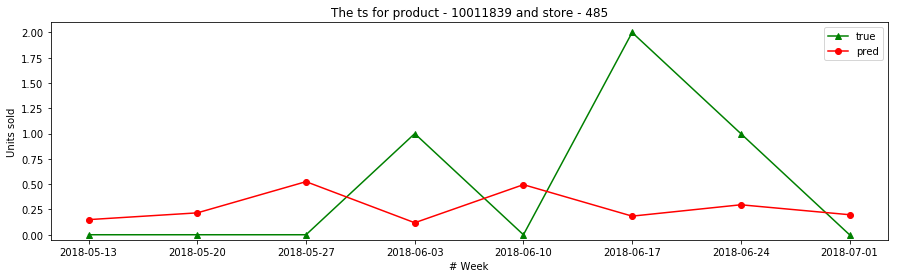

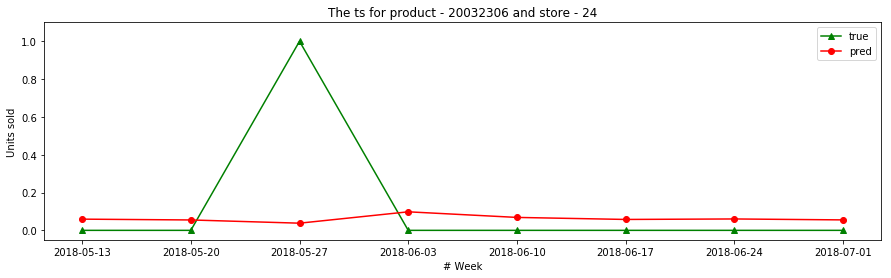

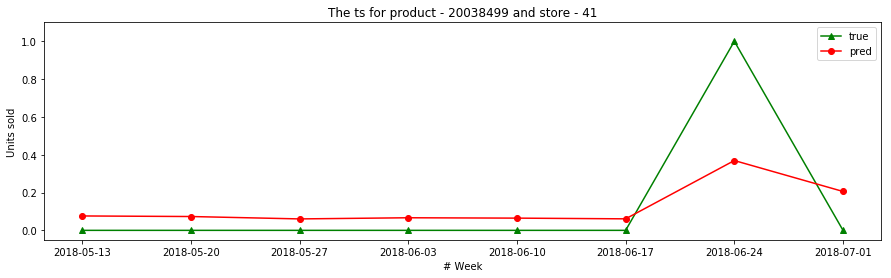

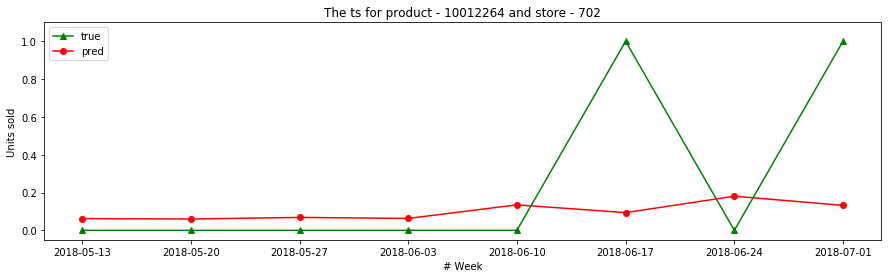

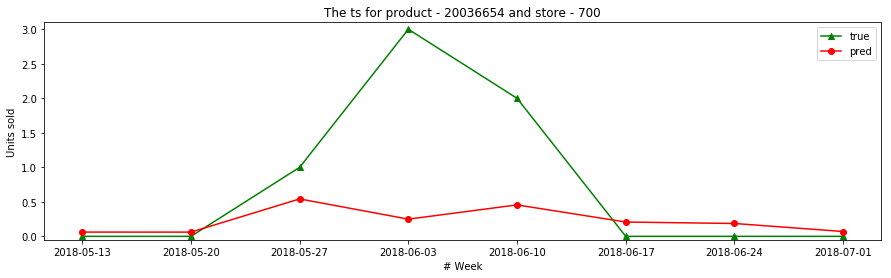

...

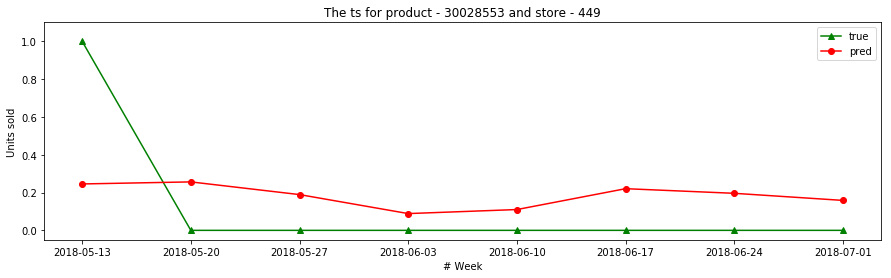

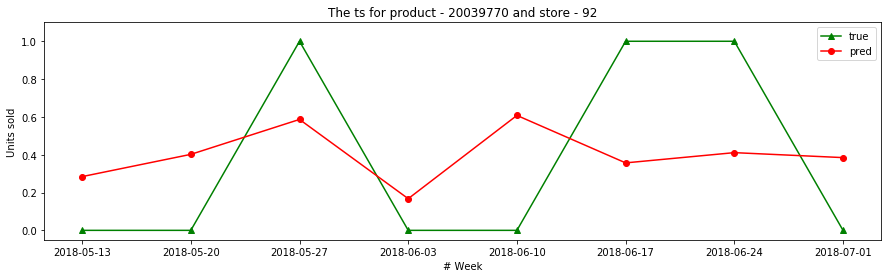

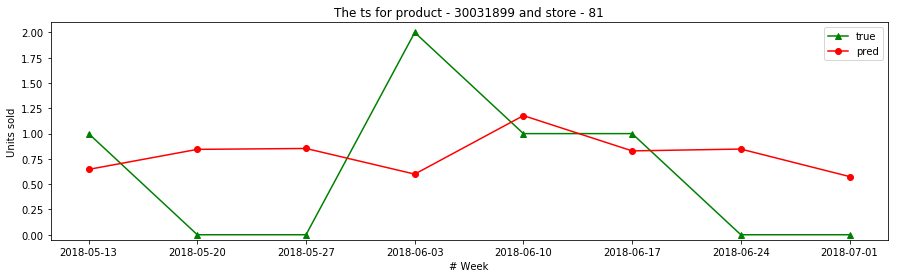

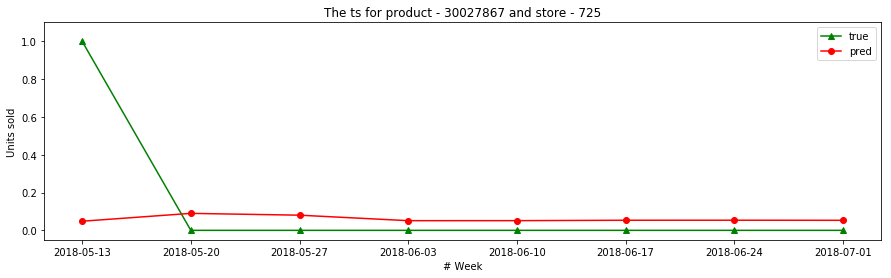

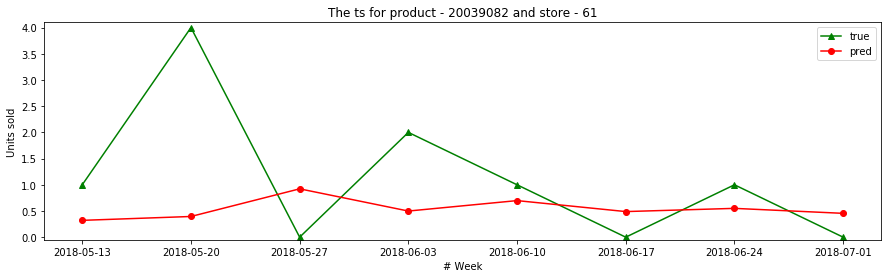

In [53]:
pairs = list(set(zip(res3['STORE_ID'], res3['PRODUCT_ID'])))

for i in range(len(pairs) // 100):
    store_id, product_id = pairs[i]
    plot_ts(res3, store_id, product_id)